In [1]:
!pip install -q pycocotools
!pip install -q fiftyone

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.9/7.9 MB 17.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.4/54.4 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.9/59.9 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.9/108.9 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.3/74.3 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 676.9/676.9 kB 21.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.5/192.5 kB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.6/89.6 kB 9.5 MB/s eta 0:00:00
  Installing build dependencie

In [2]:
import torch
import torch.nn as nn
import pandas as pd
import os
import PIL
import skimage
from skimage import io
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision.transforms as transforms
import torch.optim as optim
import torchvision.transforms.functional as FT
from torch.utils.data import Dataset, DataLoader
from tqdm import tqdm
seed = 123
import cv2
import xml.etree.ElementTree as ET
torch.manual_seed(seed)
from collections import Counter
from pycocotools.coco import COCO
from sklearn.model_selection import train_test_split
import fiftyone as fo
import fiftyone.zoo as foz
import fiftyone.utils.coco as fouc

Migrating database to v0.23.7


INFO:fiftyone.migrations.runner:Migrating database to v0.23.7


# **Model Architecture**

In [3]:
architecture_config = [
    #Tuple: (kernel_size, number of filters, strides, padding)
    (7, 64, 2, 3),
    #"M" = Max Pool Layer
    "M",
    (3, 192, 1, 1),
    "M",
    (1, 128, 1, 0),
    (3, 256, 1, 1),
    (1, 256, 1, 0),
    (3, 512, 1, 1),
    "M",
    #List: [(tuple), (tuple), how many times to repeat]
    [(1, 256, 1, 0), (3, 512, 1, 1), 4],
    (1, 512, 1, 0),
    (3, 1024, 1, 1),
    "M",
    [(1, 512, 1, 0), (3, 1024, 1, 1), 2],
    (3, 1024, 1, 1),
    (3, 1024, 2, 1),
    (3, 1024, 1, 1),
    (3, 1024, 1, 1),
    #Doesnt include fc layers
]

In [4]:
class CNNBlock(nn.Module):
    def __init__(self, in_channels, out_channels, **kwargs):
        super(CNNBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, bias=False, **kwargs)
        self.batchnorm = nn.BatchNorm2d(out_channels)
        self.leakyrelu = nn.LeakyReLU(0.1)

    def forward(self, x):
        return self.leakyrelu(self.batchnorm(self.conv(x)))

class YoloV1(nn.Module):
    def __init__(self, in_channels=3, **kwargs):
        super(YoloV1, self).__init__()
        self.architecture = architecture_config
        self.in_channels = in_channels
        self.darknet = self._create_conv_layers(self.architecture)
        self.fcs = self._create_fcs(**kwargs)

    def forward(self, x):
        x = self.darknet(x)
        return self.fcs(torch.flatten(x, start_dim=1))

    def _create_conv_layers(self, architecture):
        layers = []
        in_channels = self.in_channels

        for x in architecture:
            if type(x) == tuple:
                layers += [CNNBlock(in_channels, x[1], kernel_size=x[0], stride=x[2], padding=x[3])]
                in_channels = x[1]
            elif type(x) == str:
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
            elif type(x) == list:
                conv1 = x[0] #Tuple
                conv2 = x[1] #Tuple
                repeats = x[2] #Int

                for _ in range(repeats):
                    layers += [CNNBlock(in_channels, conv1[1], kernel_size=conv1[0], stride=conv1[2], padding=conv1[3])]
                    layers += [CNNBlock(conv1[1], conv2[1], kernel_size=conv2[0], stride=conv2[2], padding=conv2[3])]
                    in_channels = conv2[1]

        return nn.Sequential(*layers)

    def _create_fcs(self, split_size, num_boxes, num_classes):
        S, B, C = split_size, num_boxes, num_classes
        return nn.Sequential(nn.Flatten(), nn.Linear(1024 * S * S, 496), nn.Dropout(0.0), nn.LeakyReLU(0.1), nn.Linear(496, S * S * (C + B * 5)))#Original paper uses nn.Linear(1024 * S * S, 4096) not 496. Also the last layer will be reshaped to (S, S, 13) where C+B*5 = 13

# **Utility Functions**

# **Intersection Over Union**

In [5]:
def intersection_over_union(boxes_preds, boxes_labels, box_format='midpoint'):
    """
    Calculates intersection over union

    Parameters:
        boxes_preds (tensor): Predictions of Bounding Boxes (BATCH_SIZE, 4)
        boxes_labels (tensor): Correct labels of Bounding Boxes (BATCH_SIZE, 4)
        box_format (str): midpoint/corners, if boxes are (x,y,w,h) or (x1,y1,x2,y2) respectively.

    Returns:
        tensor: Intersection over union for all examples
    """
    # boxes_preds shape is (N, 4) where N is the number of bboxes
    #boxes_labels shape is (n, 4)

    if box_format == 'midpoint':
        box1_x1 = boxes_preds[..., 0:1] - boxes_preds[..., 2:3] / 2
        box1_y1 = boxes_preds[..., 1:2] - boxes_preds[..., 3:4] / 2
        box1_x2 = boxes_preds[..., 0:1] + boxes_preds[..., 2:3] / 2
        box1_y2 = boxes_preds[..., 1:2] + boxes_preds[..., 3:4] / 2
        box2_x1 = boxes_labels[..., 0:1] - boxes_labels[..., 2:3] / 2
        box2_y1 = boxes_labels[..., 1:2] - boxes_labels[..., 3:4] / 2
        box2_x2 = boxes_labels[..., 0:1] + boxes_labels[..., 2:3] / 2
        box2_y2 = boxes_labels[..., 1:2] + boxes_labels[..., 3:4] / 2

    if box_format == 'corners':
        box1_x1 = boxes_preds[..., 0:1]
        box1_y1 = boxes_preds[..., 1:2]
        box1_x2 = boxes_preds[..., 2:3]
        box1_y2 = boxes_preds[..., 3:4] # Output tensor should be (N, 1). If we only use 3, we go to (N)
        box2_x1 = boxes_labels[..., 0:1]
        box2_y1 = boxes_labels[..., 1:2]
        box2_x2 = boxes_labels[..., 2:3]
        box2_y2 = boxes_labels[..., 3:4]

    x1 = torch.max(box1_x1, box2_x1)
    y1 = torch.max(box1_y1, box2_y1)
    x2 = torch.min(box1_x2, box2_x2)
    y2 = torch.min(box1_y2, box2_y2)

    #.clamp(0) is for the case when they don't intersect. Since when they don't intersect, one of these will be negative so that should become 0
    intersection = (x2 - x1).clamp(0) * (y2 - y1).clamp(0)

    box1_area = abs((box1_x2 - box1_x1) * (box1_y2 - box1_y1))
    box2_area = abs((box2_x2 - box2_x1) * (box2_y2 - box2_y1))

    return intersection / (box1_area + box2_area - intersection + 1e-6)

# **Non-Max Supression**

In [6]:
def non_max_suppression(bboxes, iou_threshold, threshold, box_format="corners"):
    """
    Does Non Max Suppression given bboxes
    Parameters:
        bboxes (list): list of lists containing all bboxes with each bboxes
        specified as [class_pred, prob_score, x1, y1, x2, y2]
        iou_threshold (float): threshold where predicted bboxes is correct
        threshold (float): threshold to remove predicted bboxes (independent of IoU)
        box_format (str): "midpoint" or "corners" used to specify bboxes
    Returns:
        list: bboxes after performing NMS given a specific IoU threshold
    """

    assert type(bboxes) == list

    bboxes = [box for box in bboxes if box[1] > threshold]
    bboxes = sorted(bboxes, key=lambda x: x[1], reverse=True)
    bboxes_after_nms = []

    while bboxes:
        chosen_box = bboxes.pop(0)

        bboxes = [
            box
            for box in bboxes
            if box[0] != chosen_box[0]
            or intersection_over_union(
                torch.tensor(chosen_box[2:]),
                torch.tensor(box[2:]),
                box_format=box_format,
            )
            < iou_threshold
        ]

        bboxes_after_nms.append(chosen_box)

    return bboxes_after_nms

# **Mean Average Precision**

In [7]:
def mean_average_precision(
    pred_boxes, true_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5
):
    """
    Calculates mean average precision
    Parameters:
        pred_boxes (list): list of lists containing all bboxes with each bboxes
        specified as [train_idx, class_prediction, prob_score, x1, y1, x2, y2]
        true_boxes (list): Similar as pred_boxes except all the correct ones
        iou_threshold (float): threshold where predicted bboxes is correct
        box_format (str): "midpoint" or "corners" used to specify bboxes
        num_classes (int): number of classes
    Returns:
        float: mAP value across all classes given a specific IoU threshold
    """

    # list storing all AP for respective classes
    average_precisions = []

    # used for numerical stability later on
    epsilon = 1e-6

    for c in range(num_classes):
        detections = []
        ground_truths = []

        # Go through all predictions and targets,
        # and only add the ones that belong to the
        # current class c
        for detection in pred_boxes:
            if detection[1] == c:
                detections.append(detection)

        for true_box in true_boxes:
            if true_box[1] == c:
                ground_truths.append(true_box)

        # find the amount of bboxes for each training example
        # Counter here finds how many ground truth bboxes we get
        # for each training example, so let's say img 0 has 3,
        # img 1 has 5 then we will obtain a dictionary with:
        # amount_bboxes = {0:3, 1:5}
        amount_bboxes = Counter([gt[0] for gt in ground_truths])

        # We then go through each key, val in this dictionary
        # and convert to the following (w.r.t same example):
        # ammount_bboxes = {0:torch.tensor[0,0,0], 1:torch.tensor[0,0,0,0,0]}
        for key, val in amount_bboxes.items():
            amount_bboxes[key] = torch.zeros(val)

        # sort by box probabilities which is index 2
        detections.sort(key=lambda x: x[2], reverse=True)
        TP = torch.zeros((len(detections)))
        FP = torch.zeros((len(detections)))
        total_true_bboxes = len(ground_truths)

        # If none exists for this class then we can safely skip
        if total_true_bboxes == 0:
            continue

        for detection_idx, detection in enumerate(detections):
            # Only take out the ground_truths that have the same
            # training idx as detection
            ground_truth_img = [
                bbox for bbox in ground_truths if bbox[0] == detection[0]
            ]

            num_gts = len(ground_truth_img)
            best_iou = 0

            for idx, gt in enumerate(ground_truth_img):
                iou = intersection_over_union(
                    torch.tensor(detection[3:]),
                    torch.tensor(gt[3:]),
                    box_format=box_format,
                )

                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = idx

            if best_iou > iou_threshold:
                # only detect ground truth detection once
                if amount_bboxes[detection[0]][best_gt_idx] == 0:
                    # true positive and add this bounding box to seen
                    TP[detection_idx] = 1
                    amount_bboxes[detection[0]][best_gt_idx] = 1
                else:
                    FP[detection_idx] = 1

            # if IOU is lower then the detection is a false positive
            else:
                FP[detection_idx] = 1

        TP_cumsum = torch.cumsum(TP, dim=0)
        FP_cumsum = torch.cumsum(FP, dim=0)
        recalls = TP_cumsum / (total_true_bboxes + epsilon)
        precisions = torch.divide(TP_cumsum, (TP_cumsum + FP_cumsum + epsilon))
        precisions = torch.cat((torch.tensor([1]), precisions))
        recalls = torch.cat((torch.tensor([0]), recalls))
        # torch.trapz for numerical integration
        average_precisions.append(torch.trapz(precisions, recalls))

    return sum(average_precisions) / (len(average_precisions) + 1e-6)

In [8]:
def mean_average_precision_at_k(
    pred_boxes, true_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5, k=5
):
    """
    Calculates mean average precision at K (mAP@K)
    ...
    k (int): Number of top predictions to consider for each image
    """
    average_precisions = []
    epsilon = 1e-6

    for c in range(num_classes):
        detections = []
        ground_truths = []

        for detection in pred_boxes:
            if detection[1] == c:
                detections.append(detection)

        for true_box in true_boxes:
            if true_box[1] == c:
                ground_truths.append(true_box)

        amount_bboxes = Counter([gt[0] for gt in ground_truths])
        for key, val in amount_bboxes.items():
            amount_bboxes[key] = torch.zeros(val)

        # Here we sort and select top-K detections
        detections.sort(key=lambda x: x[2], reverse=True)
        detections = detections[:k]  # Select top-K

        TP = torch.zeros((len(detections)))
        FP = torch.zeros((len(detections)))
        total_true_bboxes = len(ground_truths)

        if total_true_bboxes == 0:
            continue

        for detection_idx, detection in enumerate(detections):
            ground_truth_img = [bbox for bbox in ground_truths if bbox[0] == detection[0]]
            num_gts = len(ground_truth_img)
            best_iou = 0

            for idx, gt in enumerate(ground_truth_img):
                iou = intersection_over_union(
                    torch.tensor(detection[3:]),
                    torch.tensor(gt[3:]),
                    box_format=box_format,
                )

                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = idx

            if best_iou > iou_threshold:
                if amount_bboxes[detection[0]][best_gt_idx] == 0:
                    TP[detection_idx] = 1
                    amount_bboxes[detection[0]][best_gt_idx] = 1
                else:
                    FP[detection_idx] = 1
            else:
                FP[detection_idx] = 1

        TP_cumsum = torch.cumsum(TP, dim=0)
        FP_cumsum = torch.cumsum(FP, dim=0)
        recalls = TP_cumsum / (total_true_bboxes + epsilon)
        precisions = torch.divide(TP_cumsum, (TP_cumsum + FP_cumsum + epsilon))
        precisions = torch.cat((torch.tensor([1]), precisions))
        recalls = torch.cat((torch.tensor([0]), recalls))
        average_precisions.append(torch.trapz(precisions, recalls))
        mean_ap = sum(average_precisions) / (len(average_precisions) + 1e-6)

    return mean_ap.item()

# **Last Utility Functions**

In [33]:
def get_bboxes(
    loader,
    model,
    iou_threshold,
    threshold,
    pred_format="cells",
    box_format="midpoint",
    device="cuda",
):
    all_pred_boxes = []
    all_true_boxes = []

    # make sure model is in eval before get bboxes
    model.eval()
    train_idx = 0

    for batch_idx, (x, labels) in enumerate(loader):
        x = x.to(device)
        labels = labels.to(device)

        with torch.no_grad():
            predictions = model(x)

        batch_size = x.shape[0]
        true_bboxes = cellboxes_to_boxes(labels)
        bboxes = cellboxes_to_boxes(predictions)

        for idx in range(batch_size):
            nms_boxes = non_max_suppression(
                bboxes[idx],
                iou_threshold=iou_threshold,
                threshold=threshold,
                box_format=box_format,
            )


            #if batch_idx == 0 and idx == 0:
            #    plot_image(x[idx].permute(1,2,0).to("cpu"), nms_boxes)
            #    print(nms_boxes)

            for nms_box in nms_boxes:
                all_pred_boxes.append([train_idx] + nms_box)

            for box in true_bboxes[idx]:
                # many will get converted to 0 pred
                if box[1] > threshold:
                    all_true_boxes.append([train_idx] + box)

            train_idx += 1

    model.train()
    return all_pred_boxes, all_true_boxes



def convert_cellboxes(predictions, S=7, C=5):
    """
    Converts bounding boxes output from Yolo with
    an image split size of S into entire image ratios
    rather than relative to cell ratios. Tried to do this
    vectorized, but this resulted in quite difficult to read
    code... Use as a black box? Or implement a more intuitive,
    using 2 for loops iterating range(S) and convert them one
    by one, resulting in a slower but more readable implementation.
    """

    predictions = predictions.to("cpu")
    batch_size = predictions.shape[0]
    predictions = predictions.reshape(batch_size, 7, 7, C + 10)
    bboxes1 = predictions[..., C + 1:C + 5]
    bboxes2 = predictions[..., C + 6:C + 10]
    scores = torch.cat(
        (predictions[..., C].unsqueeze(0), predictions[..., C + 5].unsqueeze(0)), dim=0
    )
    best_box = scores.argmax(0).unsqueeze(-1)
    best_boxes = bboxes1 * (1 - best_box) + best_box * bboxes2
    cell_indices = torch.arange(7).repeat(batch_size, 7, 1).unsqueeze(-1)
    x = 1 / S * (best_boxes[..., :1] + cell_indices)
    y = 1 / S * (best_boxes[..., 1:2] + cell_indices.permute(0, 2, 1, 3))
    w_y = 1 / S * best_boxes[..., 2:4]
    # print(x)
    # print(y)
    # print(w_y)
    converted_bboxes = torch.cat((x, y, w_y), dim=-1)
    predicted_class = predictions[..., :C].argmax(-1).unsqueeze(-1)
    best_confidence = torch.max(predictions[..., C], predictions[..., C + 5]).unsqueeze(
        -1
    )
    print(converted_bboxes)
    converted_preds = torch.cat(
        (predicted_class, best_confidence, converted_bboxes), dim=-1
    )

    return converted_preds


def cellboxes_to_boxes(out, S=7):
    converted_pred = convert_cellboxes(out).reshape(out.shape[0], S * S, -1)
    converted_pred[..., 0] = converted_pred[..., 0].long()
    all_bboxes = []

    for ex_idx in range(out.shape[0]):
        bboxes = []

        for bbox_idx in range(S * S):
            bboxes.append([x.item() for x in converted_pred[ex_idx, bbox_idx, :]])
        all_bboxes.append(bboxes)

    return all_bboxes

def save_checkpoint(state, filename="my_checkpoint.pth"):
    print("=> Saving checkpoint")
    torch.save(state, filename)

def load_checkpoint(checkpoint, model, optimizer):
    print("=> Loading checkpoint")
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

# **Dataset Preprocessing**

# **Model Loss**

In [10]:
class YoloLoss(nn.Module):
    """
    Calculate the loss for yolo (v1) model
    """

    def __init__(self, S=7, B=2, C=5):
        super(YoloLoss, self).__init__()
        self.mse = nn.MSELoss(reduction="sum")

        """
        S is split size of image (in paper 7),
        B is number of boxes (in paper 2),
        C is number of classes (in paper 20, in dataset 3),
        """
        self.S = S
        self.B = B
        self.C = C

        # These are from Yolo paper, signifying how much we should
        # pay loss for no object (noobj) and the box coordinates (coord)
        self.lambda_noobj = 0.5
        self.lambda_coord = 5

    def forward(self, predictions, target):
        # predictions are shaped (BATCH_SIZE, S*S(C+B*5) when inputted
        predictions = predictions.reshape(-1, self.S, self.S, self.C + self.B * 5)

        # Calculate IoU for the two predicted bounding boxes with target bbox
        iou_b1 = intersection_over_union(predictions[..., self.C + 1:self.C + 5], target[..., self.C + 1:self.C + 5])
        iou_b2 = intersection_over_union(predictions[..., self.C + 6:self.C + 10], target[..., self.C + 1:self.C + 5])
        ious = torch.cat([iou_b1.unsqueeze(0), iou_b2.unsqueeze(0)], dim=0)

        # Take the box with highest IoU out of the two prediction
        # Note that bestbox will be indices of 0, 1 for which bbox was best
        iou_maxes, bestbox = torch.max(ious, dim=0)
        exists_box = target[..., self.C].unsqueeze(3)  # in paper this is Iobj_i

        # ======================== #
        #   FOR BOX COORDINATES    #
        # ======================== #

        # Set boxes with no object in them to 0. We only take out one of the two
        # predictions, which is the one with highest Iou calculated previously.
        box_predictions = exists_box * (
            (
                bestbox * predictions[..., self.C + 6:self.C + 10]
                + (1 - bestbox) * predictions[..., self.C + 1:self.C + 5]
            )
        )

        box_targets = exists_box * target[..., self.C + 1:self.C + 5]

        # Take sqrt of width, height of boxes to ensure that
        box_predictions[..., 2:4] = torch.sign(box_predictions[..., 2:4]) * torch.sqrt(
            torch.abs(box_predictions[..., 2:4] + 1e-6)
        )
        box_targets[..., 2:4] = torch.sqrt(box_targets[..., 2:4])

        box_loss = self.mse(
            torch.flatten(box_predictions, end_dim=-2),
            torch.flatten(box_targets, end_dim=-2),
        )

        # ==================== #
        #   FOR OBJECT LOSS    #
        # ==================== #

        # pred_box is the confidence score for the bbox with highest IoU
        pred_box = (
            bestbox * predictions[..., self.C + 5:self.C + 6] + (1 - bestbox) * predictions[..., self.C:self.C + 1]
        )

        object_loss = self.mse(
            torch.flatten(exists_box * pred_box),
            torch.flatten(exists_box * target[..., self.C:self.C + 1]),
        )

        # ======================= #
        #   FOR NO OBJECT LOSS    #
        # ======================= #

        #max_no_obj = torch.max(predictions[..., 20:21], predictions[..., 25:26])
        #no_object_loss = self.mse(
        #    torch.flatten((1 - exists_box) * max_no_obj, start_dim=1),
        #    torch.flatten((1 - exists_box) * target[..., 20:21], start_dim=1),
        #)

        no_object_loss = self.mse(
            torch.flatten((1 - exists_box) * predictions[..., self.C:self.C + 1], start_dim=1),
            torch.flatten((1 - exists_box) * target[..., self.C:self.C + 1], start_dim=1),
        )

        no_object_loss += self.mse(
            torch.flatten((1 - exists_box) * predictions[..., self.C + 5:self.C + 6], start_dim=1),
            torch.flatten((1 - exists_box) * target[..., self.C:self.C + 1], start_dim=1)
        )

        # ================== #
        #   FOR CLASS LOSS   #
        # ================== #

        class_loss = self.mse(
            torch.flatten(exists_box * predictions[..., :self.C], end_dim=-2,),
            torch.flatten(exists_box * target[..., :self.C], end_dim=-2,),
        )

        loss = (
            self.lambda_coord * box_loss  # first two rows in paper
            + object_loss  # third row in paper
            + self.lambda_noobj * no_object_loss  # forth row
            + class_loss  # fifth row
        )

        return loss

# **COCO dataset**

Choose 5 classes to train model

In [11]:
classes_list = ["traffic light", "stop sign", "car", "motorcycle", "bus"]

We use fiftyone zoo to load the dataset without local download

In [12]:
dataset = foz.load_zoo_dataset(
    "coco-2017",
    split="validation",
    label_types=["detections"],
    classes=classes_list,
    # max_samples=25,
)

INFO:fiftyone.zoo.datasets:Downloading split 'validation' to '/root/fiftyone/coco-2017/validation' if necessary


INFO:fiftyone.utils.coco:Downloading annotations to '/root/fiftyone/coco-2017/tmp-download/annotations_trainval2017.zip'


 100% |██████|    1.9Gb/1.9Gb [5.5s elapsed, 0s remaining, 482.5Mb/s]       


INFO:eta.core.utils: 100% |██████|    1.9Gb/1.9Gb [5.5s elapsed, 0s remaining, 482.5Mb/s]       


Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Downloading 812 images


 100% |██████████████████| 812/812 [43.2s elapsed, 0s remaining, 18.9 images/s]      


INFO:eta.core.utils: 100% |██████████████████| 812/812 [43.2s elapsed, 0s remaining, 18.9 images/s]      


Writing annotations for 812 downloaded samples to '/root/fiftyone/coco-2017/validation/labels.json'


INFO:fiftyone.utils.coco:Writing annotations for 812 downloaded samples to '/root/fiftyone/coco-2017/validation/labels.json'


Dataset info written to '/root/fiftyone/coco-2017/info.json'


INFO:fiftyone.zoo.datasets:Dataset info written to '/root/fiftyone/coco-2017/info.json'


Loading 'coco-2017' split 'validation'


INFO:fiftyone.zoo.datasets:Loading 'coco-2017' split 'validation'


 100% |█████████████████| 812/812 [8.4s elapsed, 0s remaining, 123.6 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 812/812 [8.4s elapsed, 0s remaining, 123.6 samples/s]      


Dataset 'coco-2017-validation' created


INFO:fiftyone.zoo.datasets:Dataset 'coco-2017-validation' created


In [ ]:
!fiftyone app

In [ ]:
session = fo.launch_app(dataset)

In [13]:
classes = dataset.distinct(
    "ground_truth.detections.label"
)
id2name, name2id = {}, {}
classes_id_list = []
for class_id, class_name in enumerate(classes):
    if class_name in classes_list:
      classes_id_list.append(class_id)
    id2name[class_id] = class_name
    name2id[class_name] = class_id

In [20]:
class FiftyOneTorchDataset(torch.utils.data.Dataset):
    """A class to construct a PyTorch dataset from a FiftyOne dataset.

    Args:
        fiftyone_dataset: a FiftyOne dataset or view that will be used for training or testing
        transforms (None): a list of PyTorch transforms to apply to images and targets when loading
        gt_field ("ground_truth"): the name of the field in fiftyone_dataset that contains the
            desired labels to load
        classes (None): a list of class strings that are used to define the mapping between
            class names and indices. If None, it will use all classes present in the given fiftyone_dataset.
    """

    def __init__(
        self,
        fiftyone_dataset,
        S=7,
        B=2,
        C=5,
        transform=None,
        gt_field="ground_truth",
        classes=None,
    ):
        self.S = S
        self.B = B
        self.C = C

        self.samples = fiftyone_dataset
        self.transform = transform
        self.gt_field = gt_field

        self.img_paths = self.samples.values("filepath")

        self.classes = classes
        if not self.classes:
            # Get list of distinct labels that exist in the view
            self.classes = self.samples.distinct(
                "%s.detections.label" % gt_field
            )

        if self.classes[0] != "background":
            self.classes = ["background"] + self.classes

        self.labels_map_rev = {c: i for i, c in enumerate(self.classes)}

    def __getitem__(self, idx):
        img_path = self.img_paths[idx]
        sample = self.samples[img_path]
        metadata = sample.metadata
        img = Image.open(img_path).convert("RGB")

        boxes = []
        detections = sample[self.gt_field].detections
        for det in detections:
            category_id = self.labels_map_rev[det.label]
            coco_obj = fouc.COCOObject.from_label(
                det, metadata, category_id=category_id,
            )
            if coco_obj.category_id not in classes_id_list:
              continue
            # class_label = coco_obj.category_id - 1
            class_label = classes_id_list.index(coco_obj.category_id)
            x, y, w, h = coco_obj.bbox
            x_center = (x + w / 2) / img.size[0]
            y_center = (y + h / 2) / img.size[1]
            width = w / img.size[0]
            height = h / img.size[1]
            boxes.append([class_label, x_center, y_center, width, height])

        boxes = torch.tensor(boxes)

        if self.transform:
            img, boxes = self.transform(img, boxes)

        # Convert boxes to YOLO target format
        label_matrix = torch.zeros((self.S, self.S, self.C + 5 * self.B))
        for box in boxes:
            class_label, x, y, width, height = box.tolist()
            class_label = int(class_label)  # Преобразование в целое число

            i, j = int(self.S * y), int(self.S * x)  # Cell indices
            cell_x = self.S * x - j
            cell_y = self.S * y - i
            width_cell, height_cell = width * self.S, height * self.S

            if label_matrix[i, j, self.C] == 0:
                label_matrix[i, j, self.C] = 1
                box_coordinates = torch.tensor([cell_x, cell_y, width_cell, height_cell])
                label_matrix[i, j, self.C+1:self.C+5] = box_coordinates
                label_matrix[i, j, class_label] = 1  # Использование class_label как индекса после его преобразования в целое число



        return img, label_matrix

    def __len__(self):
        return len(self.img_paths)

    def get_classes(self):
        return self.classes

# **Model Training**

In [15]:
LEARNING_RATE = 2e-5 # 3e-4 стандарт можно попробовать
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 32 # 64 in original paper but resource exhausted error otherwise.
WEIGHT_DECAY = 0
EPOCHS = 5 #20
NUM_WORKERS = 2
PIN_MEMORY = True
LOAD_MODEL = False
LOAD_MODEL_FILE = "model.pth" # "/kaggle/working/model.pth" - положить модель сюда или обучить заново

In [16]:
class MyTransform:
    def __init__(self, resize):
        self.resize = resize  # Размер к которому будут изменены изображения

    def __call__(self, image, boxes):
        # Изменение размера изображения
        image = FT.resize(image, self.resize)
        # Преобразование PIL Image в Tensor
        image = FT.to_tensor(image)

        # Ваш код для трансформации boxes, если необходимо
        # Например, масштабирование координат ограничивающих рамок в соответствии с новым размером изображения

        return image, boxes


In [21]:
torch_dataset = FiftyOneTorchDataset(dataset, transform=MyTransform(resize=(448, 448)))
train_dataset, test_dataset = train_test_split(torch_dataset, test_size=0.2, random_state=42)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True)

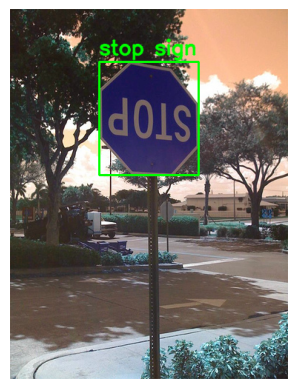

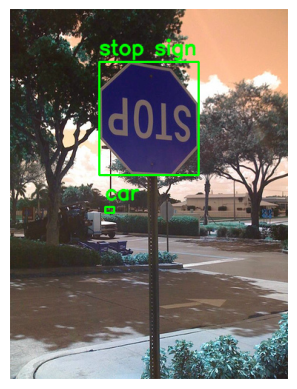

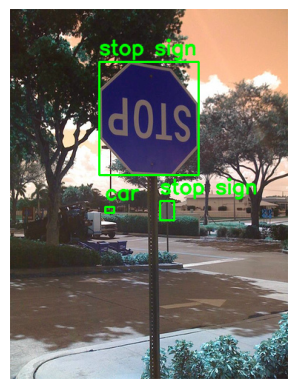

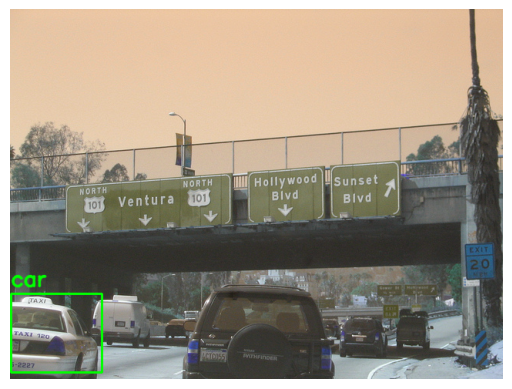

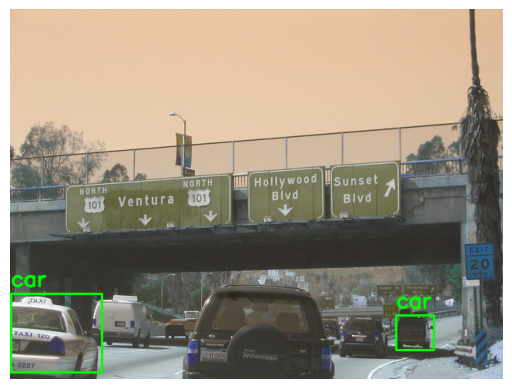

...

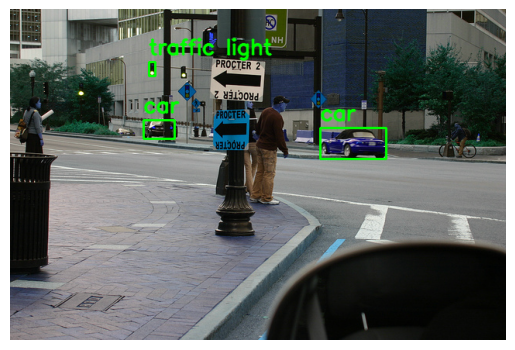

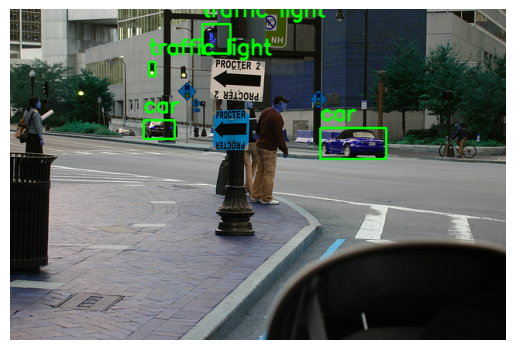

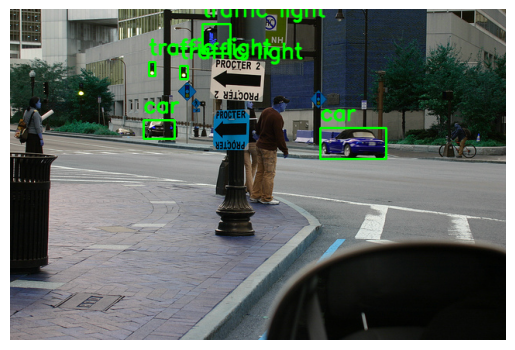

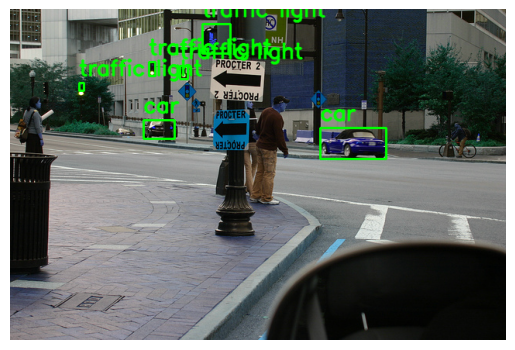

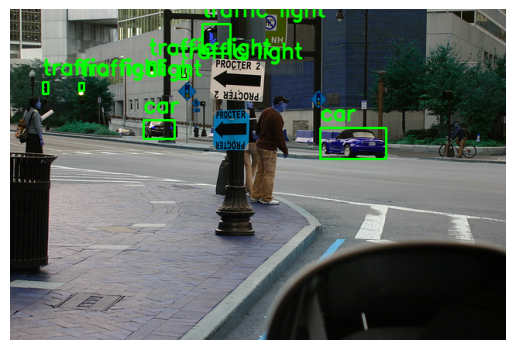

KeyboardInterrupt: 

In [ ]:
import cv2
classes = dataset.distinct(
    "ground_truth.detections.label"
)
labels_map_rev = {c: i for i, c in enumerate(classes)}
for img_path in dataset.values("filepath"):
  img = cv2.imread(img_path)
  metadata = dataset[img_path].metadata
  boxes = []
  detections = dataset[img_path]["ground_truth"].detections
  for det in detections:
      category_id = labels_map_rev[det.label]
      coco_obj = fouc.COCOObject.from_label(
          det, metadata, category_id=category_id,
      )
      if coco_obj.category_id not in classes_id_list:
        continue
      # class_label = coco_obj.category_id - 1
      class_label = classes_id_list.index(coco_obj.category_id)
      x, y, w, h = coco_obj.bbox
      x, y, w, h = int(x), int(y), int(w), int(h)
      cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
      cv2.putText(img, id2name[classes_id_list[class_label]], (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2, cv2.LINE_AA)
      plt.imshow(img)
      plt.axis('off')  # Отключение осей координат
      plt.show()

In [29]:
def convert_label_matrix_to_bboxes(label_matrix, S=7, C=5, B=2, img_size=448):
    height, width, _ = label_matrix.shape

    bboxes = []
    predicted_classes = []
    confidence = []

    for i in range(height):
        for j in range(width):
            cell_label = label_matrix[i, j]

            # Если текущая ячейка не является фоном
            if cell_label[C] != 0:
                # Вычисляем координаты ограничивающего прямоугольника
                cell_x, cell_y, width_cell, height_cell = cell_label[C+1:C+5]

                xmin = (j + cell_x - width_cell / 2).item() / S * img_size
                ymin = (i + cell_y - height_cell / 2).item() / S * img_size
                xmax = (j + cell_x + width_cell / 2).item() / S * img_size
                ymax = (i + cell_y + height_cell / 2).item() / S * img_size

                # Добавляем координаты ограничивающего прямоугольника, предсказанный класс и уверенность в соответствующие списки
                bboxes.append([xmin, ymin, xmax, ymax])
                predicted_classes.append(torch.argmax(cell_label[0:C]).item())
                confidence.append(cell_label[C])

    return np.array(bboxes), np.array(predicted_classes), np.array(confidence)

In [34]:
loop = tqdm(train_loader, leave=True)
for batch_idx, (x, y) in enumerate(loop):
  bboxes = convert_cellboxes(y)

 10%|▉         | 2/21 [00:00<00:01, 14.12it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

 29%|██▊       | 6/21 [00:00<00:01, 13.73it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

 38%|███▊      | 8/21 [00:00<00:00, 13.81it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

 57%|█████▋    | 12/21 [00:00<00:00, 13.54it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

 67%|██████▋   | 14/21 [00:01<00:00, 13.40it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

 86%|████████▌ | 18/21 [00:01<00:00, 13.48it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

100%|██████████| 21/21 [00:01<00:00, 13.98it/s]

tensor([[[[0.0000, 0.0000, 0.0000, 0.0000],
          [0.1429, 0.0000, 0.0000, 0.0000],
          [0.2857, 0.0000, 0.0000, 0.0000],
          ...,
          [0.5714, 0.0000, 0.0000, 0.0000],
          [0.7143, 0.0000, 0.0000, 0.0000],
          [0.8571, 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1429, 0.0000, 0.0000],
          [0.1429, 0.1429, 0.0000, 0.0000],
          [0.2857, 0.1429, 0.0000, 0.0000],
          ...,
          [0.5714, 0.1429, 0.0000, 0.0000],
          [0.7143, 0.1429, 0.0000, 0.0000],
          [0.8571, 0.1429, 0.0000, 0.0000]],

         [[0.0000, 0.2857, 0.0000, 0.0000],
          [0.1429, 0.2857, 0.0000, 0.0000],
          [0.2857, 0.2857, 0.0000, 0.0000],
          ...,
          [0.5714, 0.2857, 0.0000, 0.0000],
          [0.7143, 0.2857, 0.0000, 0.0000],
          [0.8571, 0.2857, 0.0000, 0.0000]],

         ...,

         [[0.0000, 0.5714, 0.0000, 0.0000],
          [0.1429, 0.5714, 0.0000, 0.0000],
          [0.2857, 0.5714, 0.0000, 0.0000],
          

  0%|          | 0/21 [00:00<?, ?it/s]

1


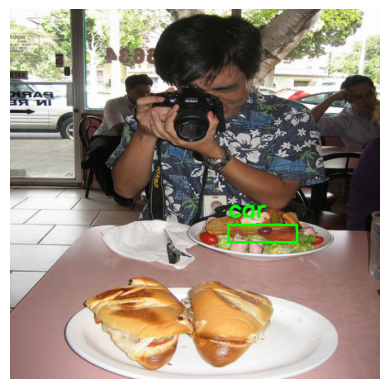

0


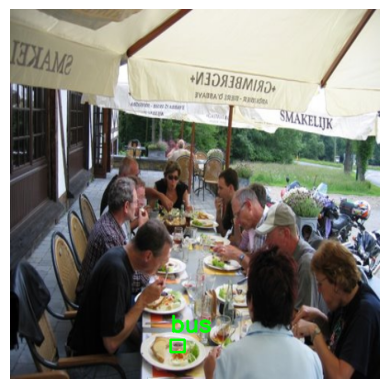

  5%|▍         | 1/21 [00:00<00:11,  1.70it/s]

3


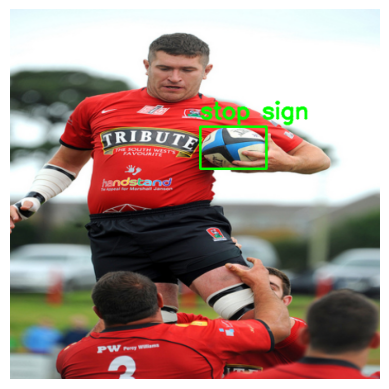

3


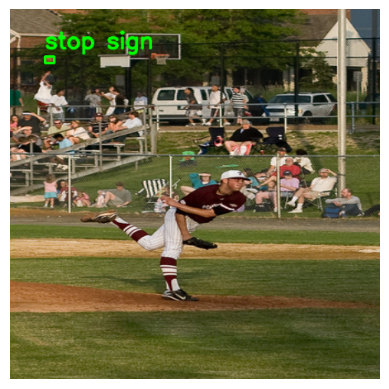

 10%|▉         | 2/21 [00:01<00:11,  1.67it/s]

2


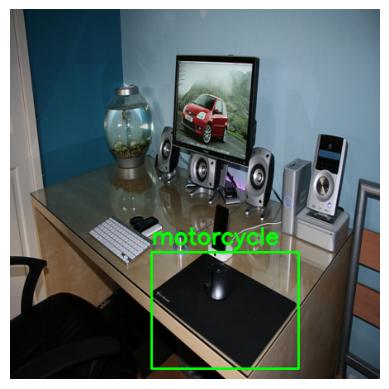

3


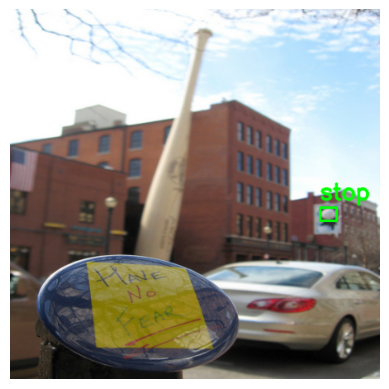

3


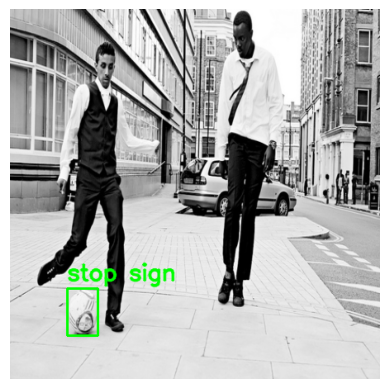

 14%|█▍        | 3/21 [00:02<00:12,  1.40it/s]

3


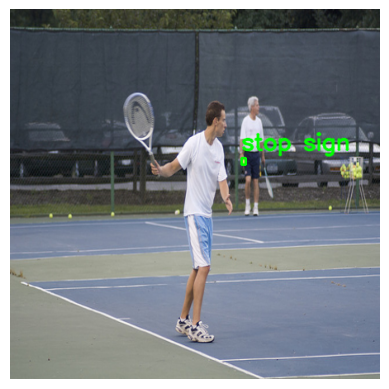

3


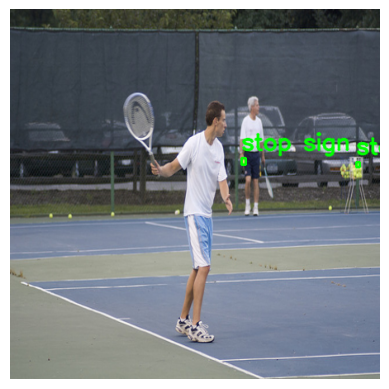

3


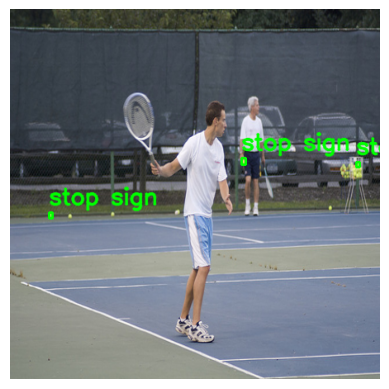

3


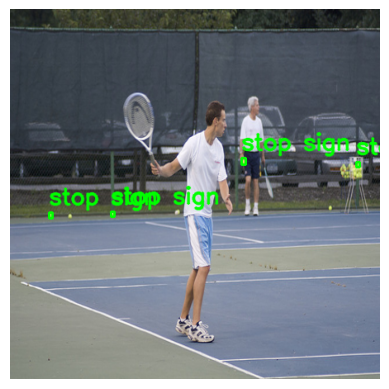

3


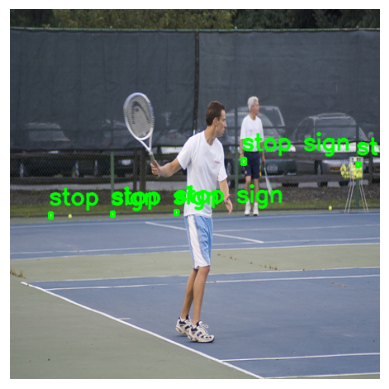

3


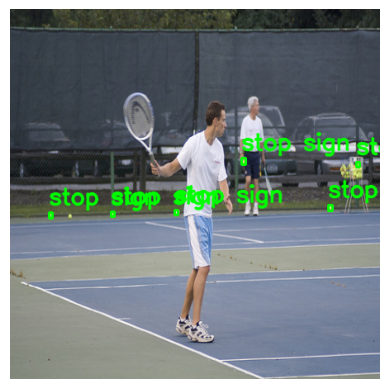

 24%|██▍       | 5/21 [00:03<00:12,  1.30it/s]

3


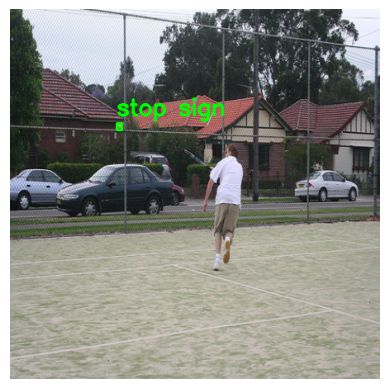

 29%|██▊       | 6/21 [00:04<00:09,  1.55it/s]

1


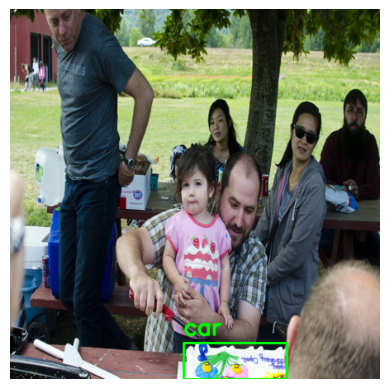

 33%|███▎      | 7/21 [00:04<00:07,  1.76it/s]

2


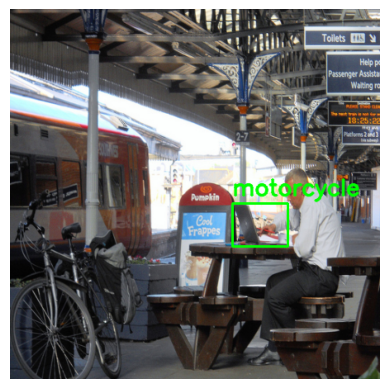

2


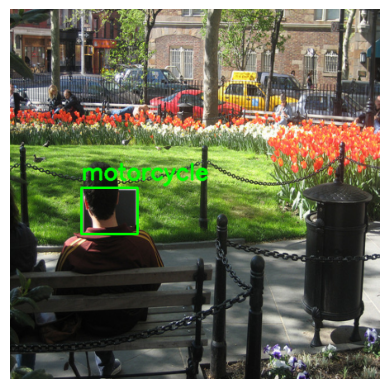

 43%|████▎     | 9/21 [00:05<00:05,  2.07it/s]

3


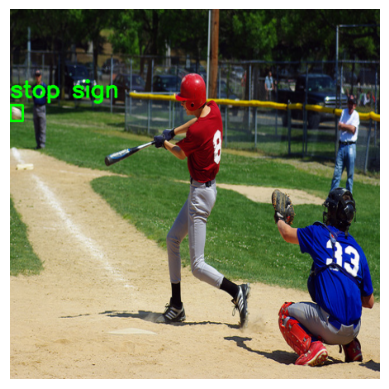

 48%|████▊     | 10/21 [00:06<00:05,  2.17it/s]

3


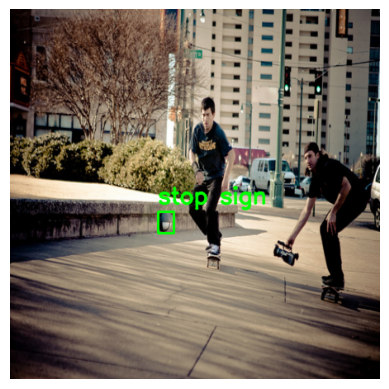

3


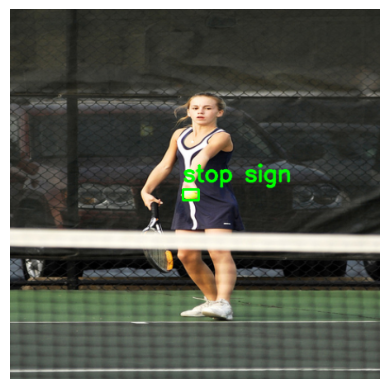

 52%|█████▏    | 11/21 [00:06<00:05,  1.78it/s]

3


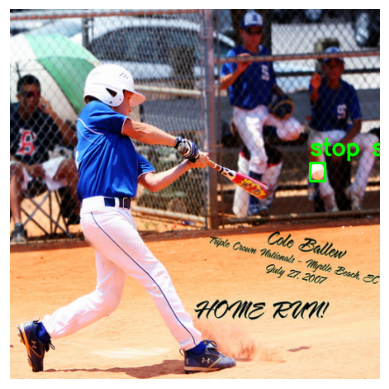

3


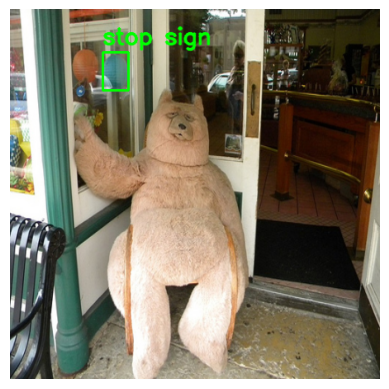

1


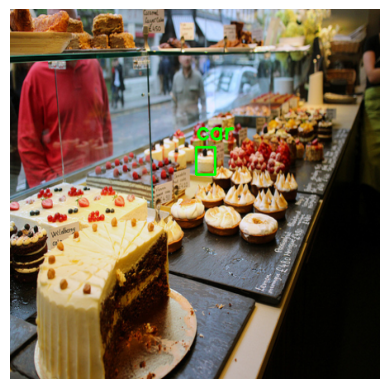

1


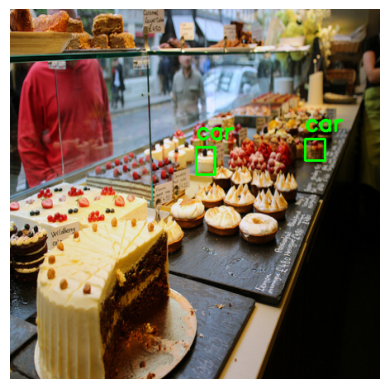

1


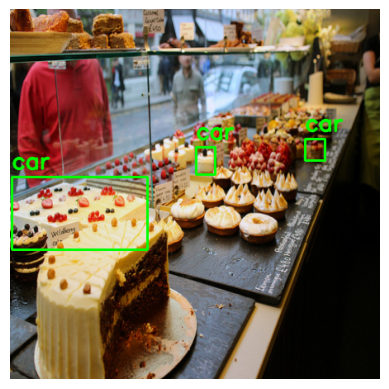

1


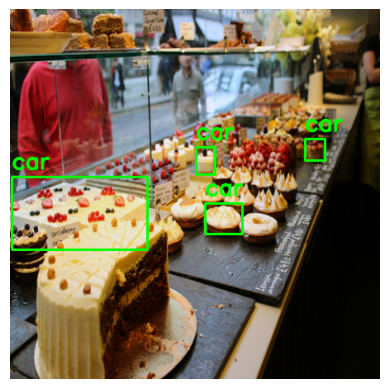

1


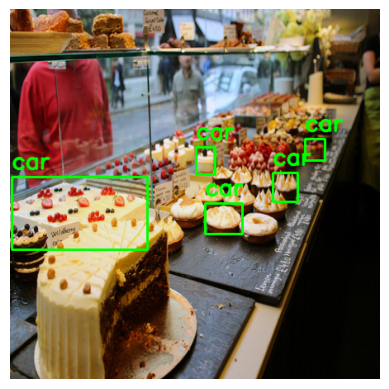

1


 52%|█████▏    | 11/21 [00:09<00:08,  1.15it/s]


KeyboardInterrupt: 

In [32]:
loop = tqdm(train_loader, leave=True)
for batch_idx, (x, y) in enumerate(loop):
  for i, label_matrix in enumerate(y):
    true_bboxes, predicted_classes, confidence = convert_label_matrix_to_bboxes(label_matrix)
    img = np.asarray(x[i])
    img = (img * 255).astype(np.uint8)
    img = np.transpose(img, (1, 2, 0))
    for j, bbox in enumerate(true_bboxes):
      if not len(bbox):
        continue
      cv2.imwrite('img.png', img)
      img = cv2.imread('img.png')
      cv2.rectangle(img, (int(bbox[0]), int(bbox[1])), (int(bbox[2]), int(bbox[3])), (0, 255, 0), 2)
      cv2.putText(img, id2name[classes_id_list[predicted_classes[j]]], (int(bbox[0]), int(bbox[1]) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2, cv2.LINE_AA)
      plt.imshow(img)
      plt.axis('off')  # Отключение осей координат
      plt.show()
      # print(true_bboxes)

In [ ]:
model = YoloV1(split_size=7, num_boxes=2, num_classes=5).to(DEVICE)
optimizer = optim.Adam(
    model.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY
)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer, factor=0.1, patience=3, mode='max', verbose=True)
loss_fn = YoloLoss()

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


In [ ]:
def train_fn(train_loader, model, optimizer, loss_fn):
  loop = tqdm(train_loader, leave=True)
  mean_loss = []

  for batch_idx, (x, y) in enumerate(loop):
      x, y = x.to(DEVICE), y.to(DEVICE)
      #x = transform(x).float().unsqueeze(0).to(DEVICE)
      out = model(x)
      loss = loss_fn(out, y)
      mean_loss.append(loss.item())
      optimizer.zero_grad()
      loss.backward()
      optimizer.step()
      # print(loss)

  print(f"Mean loss was {sum(mean_loss) / len(mean_loss)}")
  return sum(mean_loss) / len(mean_loss)

100%|██████████| 21/21 [00:14<00:00,  1.42it/s]


Mean loss was 9.420543507451104
[]
Epoch 0/5, Train mAP: 0.00000000, Mean loss: 9.4205


100%|██████████| 21/21 [00:14<00:00,  1.40it/s]


Mean loss was 0.8072428823936553
[]
Epoch 1/5, Train mAP: 0.00000000, Mean loss: 0.8072


100%|██████████| 21/21 [00:14<00:00,  1.44it/s]


Mean loss was 0.43884318144548506
[]
Epoch 2/5, Train mAP: 0.00000000, Mean loss: 0.4388


100%|██████████| 21/21 [00:14<00:00,  1.42it/s]


Mean loss was 0.3156489311229615
[]
Epoch 3/5, Train mAP: 0.00000000, Mean loss: 0.3156


100%|██████████| 21/21 [00:14<00:00,  1.42it/s]


Mean loss was 0.2678634644973846
[]
Epoch 4/5, Train mAP: 0.00000000, Mean loss: 0.2679
=> Saving checkpoint


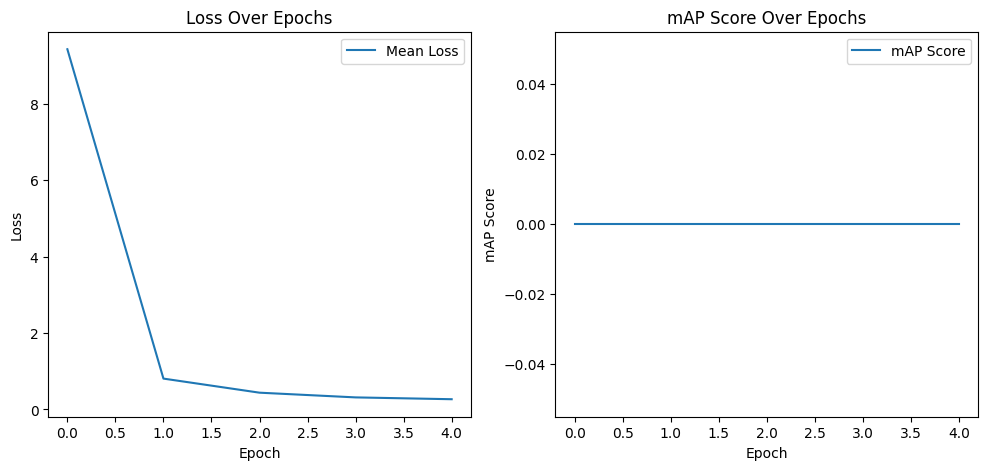

In [ ]:
# Train loop
def main():
    model = YoloV1(split_size=7, num_boxes=2, num_classes=5).to(DEVICE)
    optimizer = optim.Adam(
        model.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    )
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer, factor=0.1, patience=3, mode='max', verbose=True)
    loss_fn = YoloLoss()

    if LOAD_MODEL:
        load_checkpoint(torch.load(LOAD_MODEL_FILE), model, optimizer)

    # Списки для хранения метрик
    losses = []
    map_scores = []

    for epoch in range(EPOCHS):
        mean_loss = train_fn(train_loader, model, optimizer, loss_fn)
        losses.append(mean_loss)

        pred_boxes, target_boxes = get_bboxes(
            train_loader, model, iou_threshold=0.5, threshold=0.4, device=DEVICE # on 'cpu' try
        )

        # Вывод информации о предсказанных рамках
        # for box in pred_boxes:
        #     print(f"Индекс изображения: {box[0]}, Класс: {box[1]}, Уверенность: {box[2]:.2f}, Рамка: {box[3:]}")

        mean_avg_prec = mean_average_precision(
            pred_boxes, target_boxes, iou_threshold=0.5, box_format="midpoint"
        )
        map_scores.append(mean_avg_prec)
        print(f"Epoch {epoch}/{EPOCHS}, Train mAP: {mean_avg_prec:.8f}, Mean loss: {mean_loss:.4f}")

        scheduler.step(mean_avg_prec)

    checkpoint = {
            "state_dict": model.state_dict(),
            "optimizer": optimizer.state_dict(),
    }
    save_checkpoint(checkpoint, filename=LOAD_MODEL_FILE)

    # Построение графиков
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(losses, label='Mean Loss')
    plt.title('Loss Over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(map_scores, label='mAP Score')
    plt.title('mAP Score Over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('mAP Score')
    plt.legend()

    plt.show()


if __name__ == "__main__":
    main()

# **Predictions**

In [ ]:
LOAD_MODEL = True
EPOCHS = 1

In [ ]:
def predictions():
    model = YoloV1(split_size=7, num_boxes=2, num_classes=5).to(DEVICE)
    optimizer = optim.Adam(
        model.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    )
    loss_fn = YoloLoss()

    if LOAD_MODEL:
        load_checkpoint(torch.load(LOAD_MODEL_FILE), model, optimizer)
        # model.load_state_dict(torch.load(LOAD_MODEL_FILE, map_location='cpu'))
    # Списки для хранения метрик
    losses = []
    map_scores = []

    for epoch in range(EPOCHS):
        model.eval()
        mean_loss = train_fn(test_loader, model, optimizer, loss_fn)
        losses.append(mean_loss)

        pred_boxes, target_boxes = get_bboxes(
            test_loader, model, iou_threshold=0.5, threshold=0.4, device=DEVICE
        )

        # Вывод информации о предсказанных рамках
        for box in pred_boxes:
            print(f"Индекс изображения: {box[0]}, Класс: {box[1]}, Уверенность: {box[2]:.2f}, Рамка: {box[3:]}")


        # Draw imgs
        # visualize_predictions(model, test_loader, device=DEVICE, num_images=2)


        mean_avg_prec = mean_average_precision(
            pred_boxes, target_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5
        )

        mean_avg_prec_at_k =mean_average_precision_at_k(
            pred_boxes, target_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5, k=5
        )

        map_scores.append(mean_avg_prec)
        print(f"Epoch {epoch}/{EPOCHS}, Train mAP: {mean_avg_prec:.8f}, Mean loss: {mean_loss:.4f}")
        print(f"Epoch {epoch}/{EPOCHS}, Train mAP@K: {mean_avg_prec_at_k:.8f}")


predictions()

  0%|          | 0/1 [00:00<?, ?it/s]

=> Loading checkpoint


100%|██████████| 1/1 [00:01<00:00,  1.05s/it, loss=503]


Mean loss was 502.7106628417969
Индекс изображения: 0, Класс: 64.0, Уверенность: 0.42, Рамка: [0.4997350573539734, 0.5001726150512695, 0.5798007845878601, 0.6003434658050537]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.60, Рамка: [0.2218409925699234, 0.6427652835845947, 0.08325685560703278, 0.13197001814842224]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.56, Рамка: [0.7767442464828491, 0.6674935817718506, 0.08015580475330353, 0.10371242463588715]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.53, Рамка: [0.3521078824996948, 0.6550105810165405, 0.07827644050121307, 0.10813170671463013]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.52, Рамка: [0.08478672802448273, 0.6360276341438293, 0.057657841593027115, 0.09723847359418869]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.48, Рамка: [0.5090064406394958, 0.6508471369743347, 0.17781056463718414, 0.1969493329524994]
Индекс изображения: 1, Класс: 0.0, Уверенность: 0.46, Рамка: [0.6487657427787781, 0.6542552709579468, 0.

100%|██████████| 6/6 [00:03<00:00,  1.63it/s]


Mean loss was 0.9814855257670084


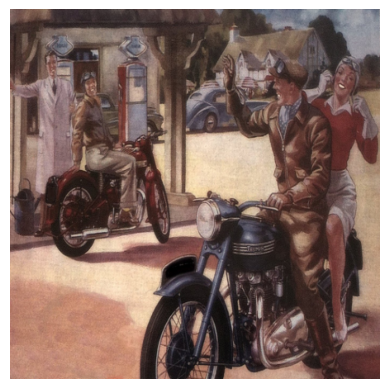

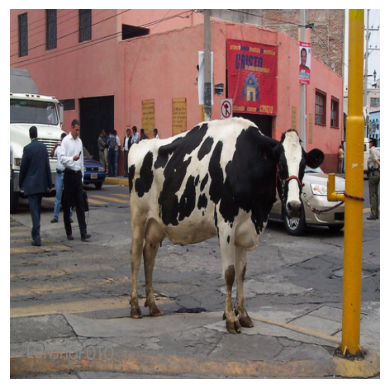

AttributeError: 'int' object has no attribute 'item'

In [ ]:
# Инференс с функцией визуализации

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from torchvision.transforms.functional import to_pil_image

def predictions():
    model = YoloV1(split_size=7, num_boxes=2, num_classes=5).to(DEVICE)
    optimizer = optim.Adam(
        model.parameters(), lr=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    )
    loss_fn = YoloLoss()

    if LOAD_MODEL:
        load_checkpoint(torch.load(LOAD_MODEL_FILE), model, optimizer)

    # Списки для хранения метрик
    losses = []
    map_scores = []

    for epoch in range(EPOCHS):
        model.eval()
        # Предполагается, что функция train_fn возвращает среднюю потерю за эпоху
        mean_loss = train_fn(test_loader, model, optimizer, loss_fn)
        losses.append(mean_loss)

        pred_boxes, target_boxes = get_bboxes(
            test_loader, model, iou_threshold=0.2, threshold=0.4, device=DEVICE
        )

        # Вывод информации о предсказанных рамках
        # for box in pred_boxes:
        #     print(f"Индекс изображения: {box[0]}, Класс: {box[1]}, Уверенность: {box[2]:.2f}, Рамка: {box[3:]}")

        num_images_print = 2  # Количество изображений для вывода
        images_shown = 0  # Счётчик показанных изображений

        for images, _ in test_loader:
            if images_shown >= num_images_print:
                break

            images = images.to(DEVICE)
            # Убираем блок with torch.no_grad(), поскольку он здесь не нужен

            for idx, image in enumerate(images):
                if images_shown >= num_images_print:
                    break

                fig, ax = plt.subplots(1)
                img = to_pil_image(image.cpu())
                ax.imshow(img)
                ax.axis('off')

                # Отфильтровываем рамки для текущего изображения
                boxes = [box for box in pred_boxes if box[0] == images_shown]
                for box in boxes:
                    print('box', box)
                    _, class_pred, confidence, rel_x1, rel_y1, rel_x2, rel_y2 = box

                    # Преобразуем относительные координаты в абсолютные
                    abs_x1 = rel_x1 * img.width
                    abs_y1 = rel_y1 * img.height
                    abs_x2 = rel_x2 * img.width
                    abs_y2 = rel_y2 * img.height

                    # Отрисовываем рамку
                    rect = patches.Rectangle((abs_x1, abs_y1), abs_x2 - abs_x1, abs_y2 - abs_y1, linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)

                    # Пишем название класса
                    text_x = abs_x1
                    text_y = abs_y1 - 10  # Расположение текста над прямоугольником
                    label = id2name[classes_id_list[class_pred]]
                    ax.text(text_x, text_y, label, color='white', fontsize=12, backgroundcolor='r')

                plt.show()
                images_shown += 1


        mean_avg_prec = mean_average_precision(
            pred_boxes, target_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5)
        map_scores.append(mean_avg_prec)

        mean_avg_prec_at_k =mean_average_precision_at_k(
            pred_boxes, target_boxes, iou_threshold=0.5, box_format="midpoint", num_classes=5, k=5
        )

        print(f"Epoch {epoch+1}/{EPOCHS}, Test mAP: {mean_avg_prec:.4f}, Mean Loss: {mean_loss:.4f}")
        print(f"Epoch {epoch}/{EPOCHS}, Train mAP@K: {mean_avg_prec_at_k:.8f}")

# Вместо предполагаемой переменной num_images используется num_images_print для определения количества выводимых изображений.
# Удалена ненужная строка с повторным предсказанием, так как pred_boxes уже содержат нужные данные.
predictions()
